
## Introducción

El objetivo de este trabajo es llevar a cabo el reconocimiento de las diferentes monedas de Argentina. Para esto se trabajó con el lenguaje de programación Python, utilizando la interfaz de Jupyter Notebook. Dentro del contexto de Python se trabajó con la librería OpenCV, lo cual presenta una gran flexibilidad en la posibilidad de migrar hacía otra plataforma, sea android u otro lenguaje de programación como C++.

### Alcance del Proyecto 

Dada las diferentes monedas utilizadas a lo largo de la historia Argentina hace falta definir el alcance del proyecto, osea para que monedas podrá funcionar correctamente.

Se programó para diferencial las monedas de \\$2, \\$1, \\$0.50 y \\$0.25. Se definió también las condiciones de las imagenes a detectar:

* Monedas separadas y con resolución de imagen cara
* Fondo solido negro

Las imagenes empleadas a lo largo del proyecto contemplan varios casos, pero no se tuvo en cuenta:

* Imágenes en blanco y negro
* Imágenes saturadas 
* Monedas recordas o solapadas



## Procesamiento de Imágenes

### Pre-procesamiento

El objetivo del pre-processamiento de imágenes es una mejor de la información provista, suprimiendo distorsiones o realzamientos no deseados. En este caso, se busca tener una imagen sin fondo que permita detectar el controrno de las monedas. Para esto se llevarán a cabo en orden los siguientes pasos:

* **Ajuste de brillo:** Se ajusta el brillo de las imagenes, para evitar que la binarización, explicada a continuación, se vea afectado por el brillo de imagen.



|Imagen Original  |  Imagen Ajuste de Brillo 
|:-: | :-:
|![alt](images_notebook\original_image.png) | ![alt](images_notebook\original_image_adj.png)


* **Conversión a escala de grisis:** Se convierte la imagen de las monedas a una de escala de grisis porque, a pesar de que ciertas monedas tienen bordes de color, esto no influye en la capacidad de detectar bordes. 

* **Filtro de mediana:** Aplicamos un filtro de mediana, cuyo objetivo es elimar imperfecciones en el fondo de la imagen, en especial ruido de tipo salt-and-pepper, común en imagenes. Esto nos permite obtener un fondo más uniforme. 

|Imagen Ajuste de Brillo   | Imagen Escala de Grisis + Filtro Mediana
|:-: | :-:
|![alt](images_notebook\original_image_adj.png) | ![alt](images_notebook\gray_scaleimage.png)

* **Binarización:** Empleando un umbral se lleva la imagen a dos colores unicamente, quedando los contornos de las monedas y posiblemente algún detalle adicional de la moneda

| Imagen Escala de Grisis + Filtro Mediana  | Imagen Binarizada
|:-: | :-:
|![alt](images_notebook\gray_scaleimage.png) | ![alt](images_notebook\binarized_image.png)

* **Erosion:** Se aplican unas pocas iteraciones de erosión para evitar que los contornos se unan al aplicar closing

|Imagen Binarizada   | Imagen con Erosión
|:-: | :-:
|![alt](images_notebook\binarized_image.png) | ![alt](images_notebook\binarized_image_erode.png)

* **Closing:** Closing consiste en dilatación seguido de erosión, ayuda a rellenar los espacios dejado al convertir la imagen en binaria.

|Imagen con Erosión   | Imagen con Closing
|:-: | :-:
|![alt](images_notebook\binarized_image_erode.png) | ![alt](images_notebook\binarized_image_closing.png)


### Detección de Contorno

El contorno de una moneda se puede ver como un cícrulo o como una elipse, según la perpesctiva en que se haya capturado la imagen. Para esto, se llevó a cabo los siguientes pasos:

1. Se buscan superficies cerradas dentro de la iamgen, estas puede ser de cualquier forma y tamaño.
2. A la superficie cerrada se le aplica la técnica de de Fitzgibbon, que se basa en buscar, mediante cuadrados minimos, la elipse que mejor se ajuste al borde de la curva. Esto se aplica en OpenCV mediante la función fitEllipse, que resulta en los puntos extremos de la elipse.
3. Se transforma la elipse en una circunference de tamaño fijo, para esto es necesario tener un circulo de referencia para que se pueda ajustar la elipse a la misma. Por lo tanto, este paso conlleva una transformación de perspectiva. Esto se aplica en OpenCV mediante la función getPerspectiveTransform.

|Imagen con Closing   | Imagen con Ellipses Detectadas
|:-: | :-:
|![alt](images_notebook\binarized_image_closing.png) | ![alt](images_notebook\image_with_ellipses.png)


### Resaltado de Detalles: Ajuste de Contraste via Ecualización de Histograma

A pesar del ajuste de brillo realizado, puedo suceder que la imagen no aproveche al máximo el histograma en cuanto a luminocidad. Consideremos una imagen cuyo pixeles se encuentras en un rango especifico de valores, por ejemplo imágenes más brillantes tendrán todos sus pixeles en valores altos. Pero una buena imagen, tendrá pixeles con valores en todo el rango, esto da la sensación de contraste. La normalización de histograma consiste en estirar este rango confinado a todo el rango de valores, esto normalmente mejora el contraste.

![alt](images_notebook\histogram_equalization.png "Histogram Equalization")

Está técnica considera el constraste global de la imagen. En muchos casos, esto puede no ser la mejor técnica a aplicar. Como ejemplo, tomemos la siguiente imagen:

|Imagen Original   | Imagen con Equalización de Histograma
|:-: | :-:
|![alt](images_notebook\clahe_original.jpg) | ![alt](images_notebook\clahe_1.jpg)

A pesar de que el detalle del fondo ha mejorado considerablemente, si comparamos la cara de la estatuas notaremos que se ha perdido mucha información debido a demasiado brillo. Esto se debe a que su histograma no se encuentra confinado a un región particular. Para resolver este problema, se usa ecualización adaptativa de histograma, que consiste en dividir la imagen en pequeños bloques llamados tiles. A cada uno de estos bloques se le aplica la técnica de ecualización de histograma visto anteriormente. De haber ruido, este será amplificado, para evitar esto se limita el contraste. Si algún bin del histograma supera cierto limite de constraste, esos pixeles son truncados y distribuidos uniformemente al resto de los bins antes de aplicar la ecualización. Finalmente, para evitar la formación de bordes artificiales entre las zonas, se emplea interpolación bilineal.

|Imagen Original   | Imagen con Equalización Adaptativa de Histograma
|:-: | :-:
|![alt](images_notebook\clahe_original.jpg) | ![alt](images_notebook\clahe_2.jpg)

Ejemplos de esta técnica aplicada a algúnas monedas argentinas:

|Imagen Original   | Imagen con Equalización Adaptativa
|:-: | :-:
|![alt](images_notebook\moneda_normal.png) | ![alt](images_notebook\moneda_histograma.png)
|![alt](images_notebook\moneda_normal1.png) | ![alt](images_notebook\moneda_histograma1.png)
|![alt](images_notebook\moneda_normal2.png) | ![alt](images_notebook\moneda_histograma2.png)




## Codigo de Detección Monedas

In [40]:
#Ramiro A Merello
#OpenCV for Image Processing 
import cv2
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.cm as cm
import math

print(cv2.__version__)


3.4.2


In [41]:
###FUNCTIONS USED IN PROYECT, from lower to higher abstracción

def increase_brightness(channel, value):
    lim = 255 - value
    channel[channel > lim] = 255
    channel[channel <= lim] += value
    return channel

def decrease_brightness(channel, value):
    lim = 0 + value
    channel[channel < lim] = 0
    channel[channel >= lim] -= value
    return channel


LUM_MIN = 40
LUM_MAX = 80
LUM_ADJ = 60
def adj_brightness_img(img):
    img_yuv = cv2.cvtColor(img, cv2.COLOR_BGR2YUV)
    y, u ,v = cv2.split(img_yuv)
    lumia_mean = cv2.mean(y)
    print(lumia_mean)
    if lumia_mean[0] < LUM_MIN:
        increase_value = LUM_ADJ - lumia_mean[0]
        increase_value = np.uint8(increase_value)
        increase_brightness(y, increase_value)
    elif lumia_mean[0] > LUM_MAX:
        decrease_value = lumia_mean[0] - LUM_MAX;
        decrease_value = np.uint8(decrease_value)
        decrease_brightness(y,decrease_value)
    
    final_yuv = cv2.merge((y, u, v))
    adj_img = cv2.cvtColor(final_yuv, cv2.COLOR_YUV2BGR)
    return adj_img

"""
This funciton will be used to increase contrast of individual coin images, this equalizes the histogram by sector and 
allows a higher level of detail in individual coins
https://stackoverflow.com/questions/31998428/opencv-python-equalizehist-colored-image
+
https://opencv-python-tutroals.readthedocs.io/en/latest/py_tutorials/py_imgproc/py_histograms/py_histogram_equalization/py_histogram_equalization.html
Equalices Histogram of image, will help with constrast of coin 
"""
def color_hist_equal(image):
    img_yuv = cv2.cvtColor(image, cv2.COLOR_BGR2YUV)
    
    #img_yuv[:,:,0] = cv2.equalizeHist(img_yuv[:,:,0]) Standard equalize
    # create a CLAHE object (Arguments are optional).
    clahe = cv2.createCLAHE(clipLimit=2.0, tileGridSize=(8,8))
     # equalize the histogram of the Y channel
    img_yuv[:,:,0] = clahe.apply(img_yuv[:,:,0])
    
    # convert the YUV image back to RGB format
    hist_equal_image = cv2.cvtColor(img_yuv, cv2.COLOR_YUV2BGR)
    return hist_equal_image

"""
#This function converts the image, to a preprocessed binary image, returns
the final binary image processed, the eroded and the gray blured image
"""
THRESHOLD = 75
EROSION_ITER = 2
CLOSING_ITER = 10
def conv_binary_image(original_img):
    #Conver to gray scale 
    gray_scale = cv2.cvtColor(original_img, cv2.COLOR_BGR2GRAY)
    
    #Apply a medianBlur to remove popcornnoise and other unwanted details or specs in background
    gray_blur = cv2.medianBlur(gray_scale,7) 
    
    #Convert to binary imagy with threshold -> use THRESH_BINARY_INV for white background
    th,thresh = cv2.threshold(gray_blur, THRESHOLD, 255, cv2.THRESH_BINARY);
    
    kernel = np.ones((3, 3), np.uint8)  
    #Apply an erosoin first to avoid coins from merging from closing(dilation+erosion)
    erosion = cv2.erode(thresh, kernel, iterations = EROSION_ITER)
    #Apply Closing to help closing contours 
    bin_closing = cv2.morphologyEx(erosion, cv2.MORPH_CLOSE, kernel, iterations = CLOSING_ITER)
    
    return bin_closing, erosion, thresh, gray_blur

"""
FUNCTION NEEDS RETOUCHING, programmed for blacked background won't use this one. Just have to change threashold and 
make adjust brightness for whitebackgrounds
"""
THRESHOLD_WHITE = 140
def conv_binary_image_whitebackground(original_img):
    #Conver to gray scale 
    gray_scale = cv2.cvtColor(original_img, cv2.COLOR_BGR2GRAY)
    
    #Apply a medianBlur to remove popcornnoise and other unwanted details or specs in background
    gray_blur = cv2.medianBlur(gray_scale,7) 
    
    #Convert to binary imagy with threshold -> use THRESH_BINARY_INV for white background
    th,thresh = cv2.threshold(gray_blur, THRESHOLD_WHITE, 255, cv2.THRESH_BINARY_INV);
    
    kernel = np.ones((3, 3), np.uint8)  
    #Apply an erosoin first to avoid coins from merging from closing(dilation+erosion)
    erosion = cv2.erode(thresh, kernel, iterations = EROSION_ITER)
    #Apply Closing to help closing contours 
    bin_closing = cv2.morphologyEx(erosion, cv2.MORPH_CLOSE, kernel, iterations = CLOSING_ITER)
    
    return bin_closing, erosion, thresh, gray_blur


"""
Rotate a point counterclockwise by a given angle around a given origin.
The angle should be given in radians.
Thanks Lucas and Pedro!
"""
def rotate(origin, point, angle):
    ox, oy = origin
    px, py = point
    qx = ox + math.cos(angle) * (px - ox) - math.sin(angle) * (py - oy)
    qy = oy + math.sin(angle) * (px - ox) + math.cos(angle) * (py - oy)
    return qx, qy

"""
A call to fitellipse in opencv will return the rotated rectangle which contains the elipse
This function will transform the elipse into a usuable set of points inside the image
"""
def transform_ellipse(ellipse):
    p1x, p1y = rotate(ellipse[0], (ellipse[0][0],ellipse[0][1]+ellipse[1][1]/2), ellipse[2]*np.pi/180)
    p2x, p2y = rotate(ellipse[0], (ellipse[0][0],ellipse[0][1]-ellipse[1][1]/2), ellipse[2]*np.pi/180)
    p3x, p3y = rotate(ellipse[0], (ellipse[0][0]+ellipse[1][0]/2,ellipse[0][1]), ellipse[2]*np.pi/180)
    p4x, p4y = rotate(ellipse[0], (ellipse[0][0]-ellipse[1][0]/2,ellipse[0][1]), ellipse[2]*np.pi/180)
    return  np.float32([[p1x,p1y], [p2x,p2y], [p3x,p3y], [p4x,p4y]])
    
    
#DEFINES
CONT_MIN_POINTS = 10
CONT_MIN_AREA = 4000
CONT_MAX_AREA = 60000000
"""
This function recieves a binary and returns the contours fitted to ellipses,
min amount of points CONT_MIN_POINTS
min area of contour CONT_MIN_AREA
max area of contour CONT_MAX_AREA
"""
def get_ellipses_contours(binary_image):
    coins_contours = []
    #Find contours modifies source that is why a copy is passed
    #Returns Array of points in contours, image is the source modifies, hierachy is relation between contorurs
    image, contours, hierarchy = cv2.findContours(binary_image.copy(), cv2.RETR_EXTERNAL, 
                                                  cv2.CHAIN_APPROX_SIMPLE)
    for i in contours:
        if len(i) > CONT_MIN_POINTS:
            area = cv2.contourArea(i)
            if area > CONT_MIN_AREA and area < CONT_MAX_AREA:
                ellipse = cv2.fitEllipse(i)
                coins_contours.append(ellipse) #Add to list of coins
    return coins_contours


HEIGHT_OUTPUT = 450
WIDTH_OUTPUT = 450

"""
This function recieves the image and a elipse surrounding a coin and returns the 
coin in a rectangle of WIDTH_OUTPUTxHEIGH_OUTPUT
"""
def transform_getcoin(image, ellipse):
    orig_pts = transform_ellipse(ellipse)
    #Transform to rectangle
    result_pts = np.float32([[0,HEIGHT_OUTPUT/2], [WIDTH_OUTPUT,HEIGHT_OUTPUT/2],
                             [WIDTH_OUTPUT/2,HEIGHT_OUTPUT], [WIDTH_OUTPUT/2,0]] ) 
    trans_matrix = cv2.getPerspectiveTransform(orig_pts, result_pts)
    result_image = cv2.warpPerspective(image, trans_matrix, (HEIGHT_OUTPUT, WIDTH_OUTPUT))    
    #Histogram Equalization to assure Contrast and be invarient towards the lighting
    # create a CLAHE object (Arguments are optional).-> Eqalization by sectors
    #clahe = cv2.createCLAHE(clipLimit = 2.0, tileGridSize = (8,8))
    #result_image = clahe.apply(result_image)
    return result_image




"""
Returns 
    -Image_result: WILL MODIFY original image, will add coin contours 
    -coin_images[]: each individual coin. This have been histogram equalized to 
    improve constrast
"""
ELLIPSE_COLOR_RGB = (164,218,246)
ELLIPSE_THICKNESS = 8
def get_all_coins(image):
    coin_contour = []
    coin_images = []
    
    image_result = image.copy()
    image_result = adj_brightness_img(image_result)
    bin_closing, erosion, thresh, gray_blur = conv_binary_image(image_result)

    coin_contours = get_ellipses_contours(bin_closing)
    for ellip_cont in coin_contours:
        coin_images.append(transform_getcoin(image_result, ellip_cont)) #Get individual coins
    for ellip_cont in coin_contours:
        cv2.ellipse(image, ellip_cont, ELLIPSE_COLOR_RGB, ELLIPSE_THICKNESS) #Draw elipses(miami blue) on image_result
   #Equalizes histogram per sector, gives the coin better contrast
    fig, ax = plt.subplots(figsize=(8, 6))
    ax.axis('off')
    ax.imshow(bin_closing)
    for i in range(len(coin_images)):
        coin_images[i] = color_hist_equal( coin_images[i])
    return image, coin_images
   # return image_result, coin_images 


"""
FUNCTION NEEDS RETOUCHING, programmed for blacked background won't use this one. Just have to change threashold and 
make adjust brightness for whitebackgrounds
Returns 
    -Image_result: WILL MODIFY original image, will add coin contours 
    -coin_images[]: each individual coin. This have been histogram equalized to 
    improve constrast
"""
ELLIPSE_COLOR_RGB = (164,218,246)
ELLIPSE_THICKNESS = 8
def get_all_coins_whitebackground(image):
    coin_contour = []
    coin_images = []
    
    image_result = image.copy()
   # image_result = adj_brightness_img(image_result) MAKE ONE FOR whitebackground 
    bin_closing, erosion, thresh, gray_blur = conv_binary_image_whitebackground(image_result)
    bin_images.append(bin_closing)
    coin_contours = get_ellipses_contours(bin_closing)
    
    fig, ax = plt.subplots(figsize=(8, 6))
    ax.axis('off')
    ax.imshow(bin_closing)
    
    for ellip_cont in coin_contours:
        coin_images.append(transform_getcoin(image_result, ellip_cont)) #Get individual coins
    for ellip_cont in coin_contours:
        cv2.ellipse(image, ellip_cont, ELLIPSE_COLOR_RGB , ELLIPSE_THICKNESS) #Draw elipses(miami blue) on image_result
   #Equalizes histogram per sector, gives the coin better contrast
    for i in range(len(coin_images)):
        coin_images[i] = color_hist_equal( coin_images[i])
    return image, coin_images
   # return image_result, coin_images 

## Code used to extract various stages of transformation  

(31.279234921279304, 0.0, 0.0, 0.0)


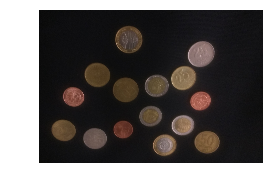

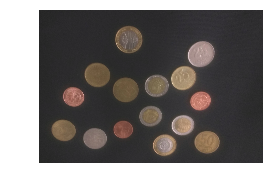

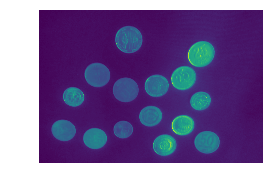

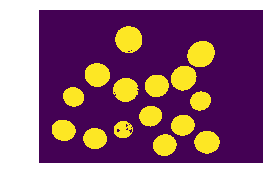

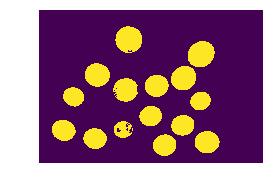

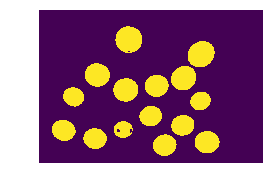

In [42]:
test_img = cv2.imread('rawdataset/blackbackground/6.jpg')
test_img = cv2.cvtColor(test_img, cv2.COLOR_RGB2BGR)
original_img = test_img
test_img = adj_brightness_img(test_img)
original_img_adj = test_img

bin_closing, erosion, thresh, gray_blur = conv_binary_image(test_img)

#Original Image
fig, ax = plt.subplots(figsize=(4, 3))
ax.axis('off')
ax.imshow(original_img)

#Original Image
fig, ax = plt.subplots(figsize=(4, 3))
ax.axis('off')
ax.imshow(original_img_adj)

fig, ax = plt.subplots(figsize=(4, 3))
ax.axis('off')
ax.imshow(gray_blur)

fig, ax = plt.subplots(figsize=(4, 3))
ax.axis('off')
ax.imshow(thresh)

fig, ax = plt.subplots(figsize=(4, 3))
ax.axis('off')
ax.imshow(erosion)

fig, ax = plt.subplots(figsize=(4, 3))
ax.axis('off')
ax.imshow(bin_closing)





C:\Users\Chewbacca\Anaconda3\lib\site-packages\matplotlib\pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


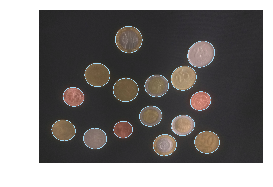

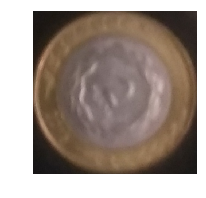

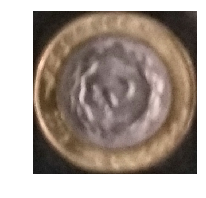

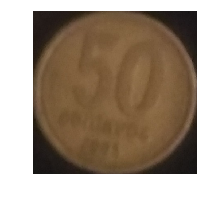

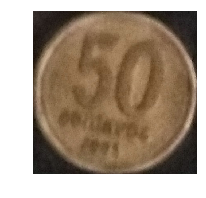

...

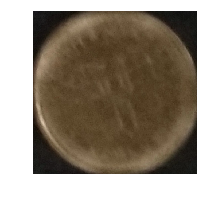

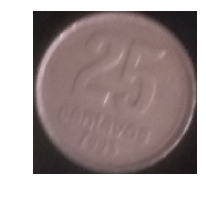

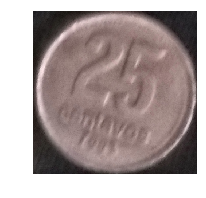

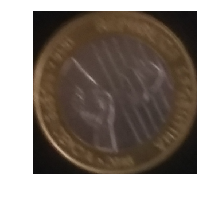

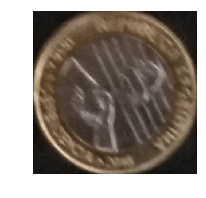

In [45]:
coin_contours = get_ellipses_contours(bin_closing)
coin_images = []

for i in coin_contours:
    coin_images.append(transform_getcoin(original_img, i)) #Get individual coins
    cv2.ellipse(test_img, i, (164,218,246), 8) #Draw elipses 
    
fig, ax = plt.subplots(figsize=(4, 3))
ax.imshow(test_img) #Img with morders
ax.axis('off')
    
for i in coin_images:
    fig, ax = plt.subplots(figsize=(4, 3))
    ax.imshow(i)
    ax.axis('off')
    i = color_hist_equal(i)
    fig, ax = plt.subplots(figsize=(4, 3))
    ax.imshow(i)
    ax.axis('off')




(46.26205080361018, 0.0, 0.0, 0.0)
(45.98233630574825, 0.0, 0.0, 0.0)
(68.07037474791687, 0.0, 0.0, 0.0)
(28.208137294069633, 0.0, 0.0, 0.0)
(47.147450830309076, 0.0, 0.0, 0.0)
(42.693309135697355, 0.0, 0.0, 0.0)
(57.60113903876759, 0.0, 0.0, 0.0)
(39.26932655479345, 0.0, 0.0, 0.0)
(37.464135470726234, 0.0, 0.0, 0.0)
(41.81919861172377, 0.0, 0.0, 0.0)
(87.86209143804132, 0.0, 0.0, 0.0)
(42.704537741464286, 0.0, 0.0, 0.0)
(26.14246640058163, 0.0, 0.0, 0.0)
(24.779252308787168, 0.0, 0.0, 0.0)
(27.890856004186617, 0.0, 0.0, 0.0)
(41.571309217356664, 0.0, 0.0, 0.0)
(38.81706584465227, 0.0, 0.0, 0.0)
(45.43022851815748, 0.0, 0.0, 0.0)
(45.30135971030421, 0.0, 0.0, 0.0)
(41.79333145862829, 0.0, 0.0, 0.0)
(39.77560803997951, 0.0, 0.0, 0.0)


C:\Users\Chewbacca\Anaconda3\lib\site-packages\matplotlib\pyplot.py:537: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  max_open_warning, RuntimeWarning)


(70.80290688216108, 0.0, 0.0, 0.0)
(45.120350074900976, 0.0, 0.0, 0.0)


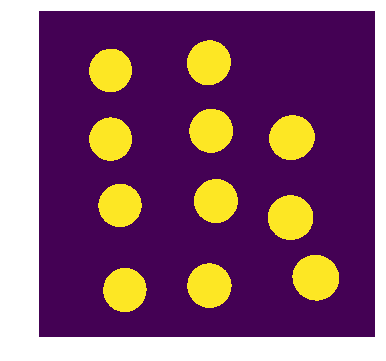

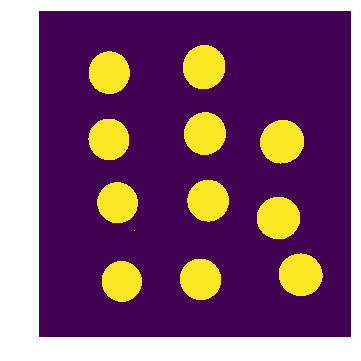

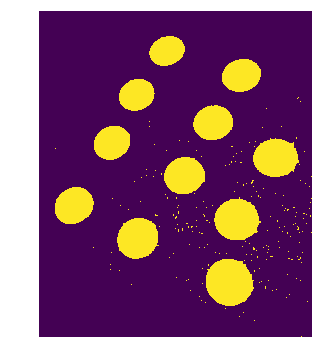

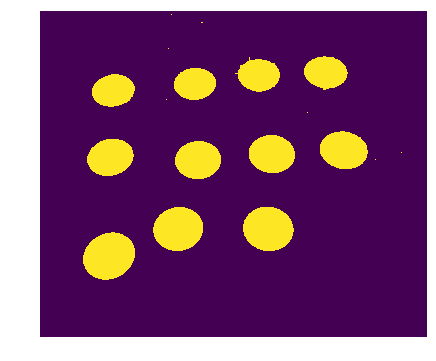

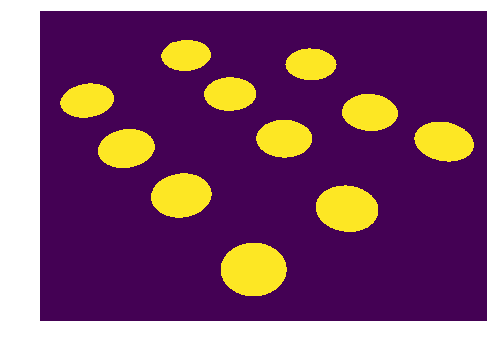

...

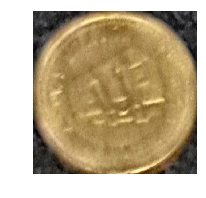

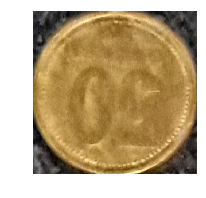

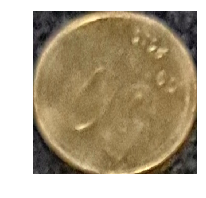

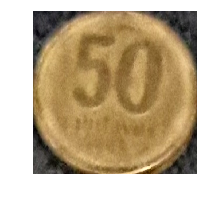

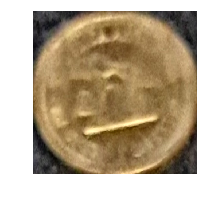

In [37]:
#Create data set for black background
import glob

images = [cv2.imread(file) for file in glob.glob('rawdataset/mineblackbackground/monedaslimpias/50/*jpg')]
bin_images = []
coin_images = []
coin_images_temp = []


for i in range(len(images)):
    images[i] = cv2.cvtColor(images[i], cv2.COLOR_RGB2BGR)
    images[i], coin_images_temp = get_all_coins(images[i])
    coin_images.extend(coin_images_temp)


for i in range(len(images)):
    fig, ax = plt.subplots(figsize=(8, 6))
    ax.axis('off')
    ax.imshow(images[i])

for i in range(len(coin_images)):
    filename = "rawdataset/mineblackbackground/monedaslimpias/50separadas/moneda50_%d.jpg"%i
    cv2.imwrite(filename, cv2.cvtColor(coin_images[i], cv2.COLOR_BGR2RGB))
    fig, ax = plt.subplots(figsize=(3, 3))
    ax.imshow(coin_images[i])
    ax.axis('off')
    


## Codigo Clasificación mediante Red Neuronal



In [15]:
#Create Data set https://gist.github.com/fchollet/0830affa1f7f19fd47b06d4cf89ed44d
#Base on https://github.com/amyoshino/Identifying-Brazilian-Coins-with-CNN/blob/master/Brazilian_coins_CNN.ipynb
#Keras 
from keras.models import Sequential
from keras.layers import Conv2D, MaxPooling2D
from keras.layers import Activation, Dropout, Flatten, Dense
from keras.models import model_from_json
from keras.preprocessing.image import ImageDataGenerator
from keras import backend as K
import os
import keras

# dimensions of our images.
img_width, img_height = 450, 450

train_data_dir = 'dataset/train'
test_data_dir = 'dataset/validation'
nb_train_samples = 110
nb_test_samples = 15
epochs = 50
batch_size = 16

if K.image_data_format() == 'channels_first':
    my_input_shape = (3, img_width, img_height)
else:
    my_input_shape = (img_width, img_height, 3)

# this is the augmentation configuration we will use for training
train_datagen = ImageDataGenerator(
    rescale=1. / 255,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True)

# this is the augmentation configuration we will use for testing:
test_datagen = ImageDataGenerator(rescale=1. / 255) # only rescaling

training_set = train_datagen.flow_from_directory(
    train_data_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    class_mode='sparse')

test_set = test_datagen.flow_from_directory(
    test_data_dir,
    target_size=(img_width, img_height),
    batch_size=batch_size,
    class_mode='sparse')



Found 440 images belonging to 4 classes.
Found 60 images belonging to 4 classes.


In [16]:
#Initializing CNN
classifier = Sequential()

# Creating Convolution layer
classifier.add(Conv2D(32, (5, 5), input_shape = my_input_shape, activation = 'relu'))

# Applying Pooling 
classifier.add(MaxPooling2D(pool_size = (2, 2)))

# Adding a second convolutional layer
classifier.add(Conv2D(32, (3, 3), activation = 'relu'))
classifier.add(MaxPooling2D(pool_size = (2, 2)))

# Adding a third convolutional layer
classifier.add(Conv2D(64, (3, 3), activation = 'relu'))
classifier.add(MaxPooling2D(pool_size = (2, 2)))

# Adding a fourth convolutional layer
classifier.add(Conv2D(64, (3, 3), activation = 'relu'))
classifier.add(MaxPooling2D(pool_size = (2, 2)))

# Adding dropout
classifier.add(Dropout(0.2))

# Flattening
classifier.add(Flatten())

In [17]:
#Connecting everything and compiling!
classifier.add(Dense(units = 128, activation = 'relu'))
classifier.add(Dense(units = 5, activation = 'softmax'))

# Compiling the CNN
optimizer = keras.optimizers.Adam(lr=0.0001, beta_1=0.9, beta_2=0.999, epsilon=1e-08, decay=0.0)
classifier.compile(optimizer = optimizer, loss = 'sparse_categorical_crossentropy', metrics = ['accuracy'])

In [18]:
classifier.fit_generator(training_set,
                         steps_per_epoch = 78,
                         epochs = 30,
                         validation_data = test_set,
                         validation_steps = 15)


Epoch 1/30
78/78 [==============================] - 543s 7s/step - loss: 1.2348 - acc: 0.4552 - val_loss: 1.2240 - val_acc: 0.4667
Epoch 2/30
78/78 [==============================] - 596s 8s/step - loss: 0.8791 - acc: 0.6194 - val_loss: 0.6174 - val_acc: 0.7333
Epoch 3/30
78/78 [==============================] - 624s 8s/step - loss: 0.6390 - acc: 0.7147 - val_loss: 0.5620 - val_acc: 0.7500
Epoch 4/30
78/78 [==============================] - 610s 8s/step - loss: 0.5240 - acc: 0.7765 - val_loss: 0.4166 - val_acc: 0.8167
Epoch 5/30
78/78 [==============================] - 610s 8s/step - loss: 0.4208 - acc: 0.8173 - val_loss: 0.3991 - val_acc: 0.8167
Epoch 6/30
78/78 [==============================] - 617s 8s/step - loss: 0.3236 - acc: 0.8686 - val_loss: 0.3411 - val_acc: 0.8167
Epoch 7/30
78/78 [==============================] - 612s 8s/step - loss: 0.3058 - acc: 0.8710 - val_loss: 0.3673 - val_acc: 0.8333
Epoch 8/30
78/78 [==============================] - 627s 8s/step - loss: 0.2941 - a

In [19]:
#Evaluating Model
classifier.evaluate_generator(test_set, steps = 32)

[0.1658226984164988, 0.9000000019868215]

In [31]:
# serialize model to JSON
model_json = classifier.to_json()
with open("model_final.json", "w") as json_file:
    json_file.write(model_json)
# serialize weights to HDF5
classifier.save_weights("model_final.h5")
print("Saved model to disk")

Saved model to disk


In [34]:
#Available clases
print(training_set.class_indices)

{'moneda1': 0, 'moneda2': 1, 'moneda25': 2, 'moneda50': 3}


In [36]:
#Testing result
from keras.preprocessing import image
import numpy as np


test_image = image.load_img('1-1.jpg', target_size = (450, 450))
test_image = image.img_to_array(test_image)
test_image = np.expand_dims(test_image, axis = 0)
result = classifier.predict_classes(test_image)
print(result)

test_image = image.load_img('1-2.jpg', target_size = (450, 450))
test_image = image.img_to_array(test_image)
test_image = np.expand_dims(test_image, axis = 0)
result = classifier.predict_classes(test_image)
print(result)

test_image = image.load_img('25-1.jpg', target_size = (450, 450))
test_image = image.img_to_array(test_image)
test_image = np.expand_dims(test_image, axis = 0)
result = classifier.predict_classes(test_image)
print(result)

test_image = image.load_img('2-1.jpg', target_size = (450, 450))
test_image = image.img_to_array(test_image)
test_image = np.expand_dims(test_image, axis = 0)
result = classifier.predict_classes(test_image)
print(result)

test_image = image.load_img('50-4.jpg', target_size = (450, 450))
test_image = image.img_to_array(test_image)
test_image = np.expand_dims(test_image, axis = 0)
result = classifier.predict_classes(test_image)
print(result)

test_image = image.load_img('2-1.jpg', target_size = (450, 450))
test_image = image.img_to_array(test_image)
test_image = np.expand_dims(test_image, axis = 0)
result = classifier.predict_classes(test_image)
print(result)






[0]
[0]
[0]
[1]
[3]
[1]
